<div align="center">

  <a href="https://ultralytics.com/yolov8" target="_blank">
    <img width="1024", src="https://raw.githubusercontent.com/ultralytics/assets/main/yolov8/banner-yolov8.png"></a>


<br>
  <a href="https://console.paperspace.com/github/ultralytics/ultralytics"><img src="https://assets.paperspace.io/img/gradient-badge.svg" alt="Run on Gradient"/></a>
  <a href="https://colab.research.google.com/github/ultralytics/ultralytics/blob/main/examples/tutorial.ipynb"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"></a>
  <a href="https://www.kaggle.com/ultralytics/yolov8"><img src="https://kaggle.com/static/images/open-in-kaggle.svg" alt="Open In Kaggle"></a>
<br>

Welcome to the Ultralytics YOLOv8 🚀 notebook! <a href="https://github.com/ultralytics/ultralytics">YOLOv8</a> is the latest version of the YOLO (You Only Look Once) AI models developed by <a href="https://ultralytics.com">Ultralytics</a>. This notebook serves as the starting point for exploring the various resources available to help you get started with YOLOv8 and understand its features and capabilities.

YOLOv8 models are fast, accurate, and easy to use, making them ideal for various object detection and image segmentation tasks. They can be trained on large datasets and run on diverse hardware platforms, from CPUs to GPUs.

We hope that the resources in this notebook will help you get the most out of YOLOv8. Please browse the YOLOv8 <a href="https://docs.ultralytics.com/">Docs</a> for details, raise an issue on <a href="https://github.com/ultralytics/ultralytics">GitHub</a> for support, and join our <a href="https://discord.gg/n6cFeSPZdD">Discord</a> community for questions and discussions!

</div>

In [1]:
%cd /kaggle/working

/kaggle/working


In [2]:
!ls

__notebook__.ipynb


In [3]:
!mkdir results

In [4]:
%pip install ultralytics
import ultralytics
ultralytics.checks()

Ultralytics YOLOv8.0.131 🚀 Python-3.10.10 torch-2.0.0 CUDA:0 (Tesla T4, 15110MiB)
Setup complete ✅ (2 CPUs, 15.6 GB RAM, 4813.6/8062.4 GB disk)


In [5]:
import cv2
from ultralytics import YOLO
def return_bbox(file):
    model = YOLO('/kaggle/input/weight-ver01/best_cornell.pt')
    results = model('/kaggle/input/cornell-grasp/cornell_dataset/test/images/%s'%file)
    boxes = results[0].boxes
    bboxs = []
    angles = []
    for box in boxes:

        box_xywh = box.xywh.tolist()
        box_xyxy = box.xyxy.tolist()
        box_data = box.data.tolist()
        bbox = [box_xyxy[0][0], box_xyxy[0][1], box_xywh[0][2], box_xywh[0][3]]
        bboxs.append(bbox)
        angle = int(box_data[0][5]) *20 + 10
        angles.append(angle)
    return bboxs, angles

/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl6StatusC1EN10tensorflow5error4CodeESt17basic_string_viewIcSt11char_traitsIcEENS_14SourceLocationE']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/opt/conda/lib/python3.10/site-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZTVN10tenso

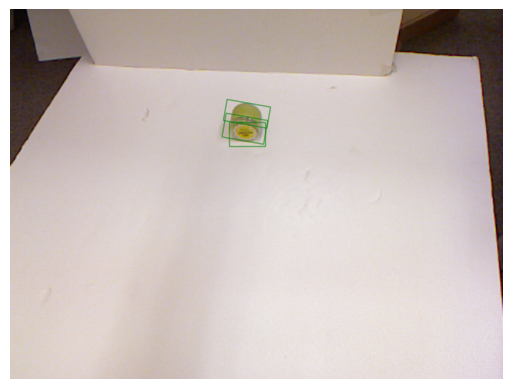

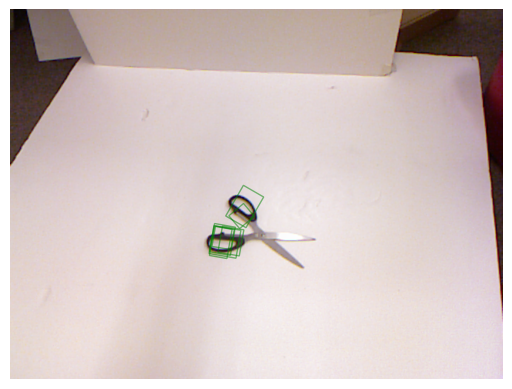

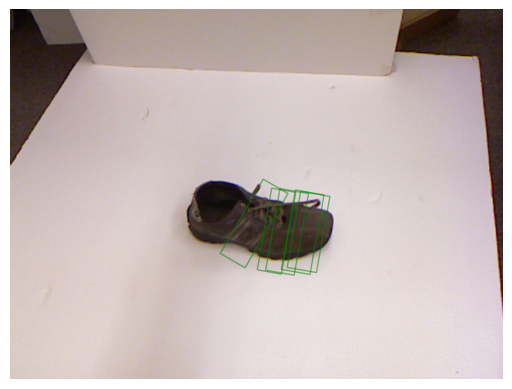

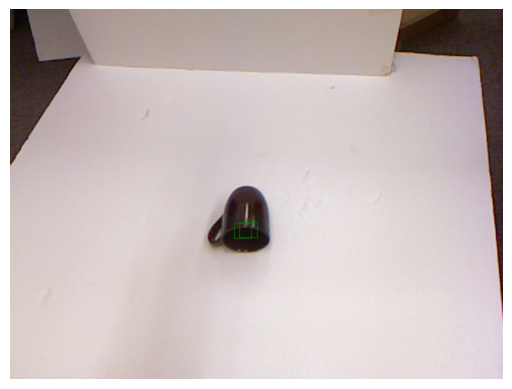

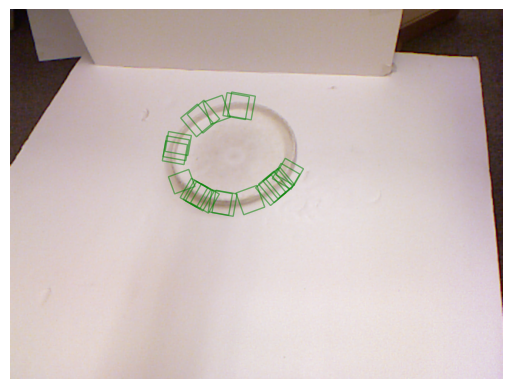

...

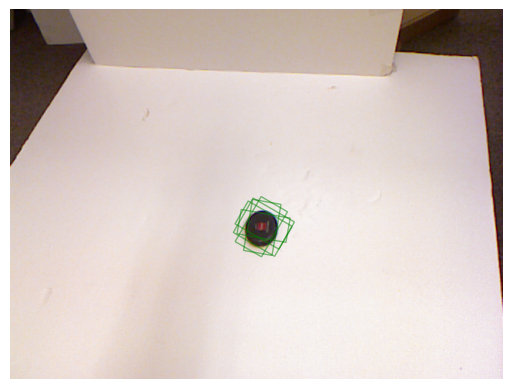

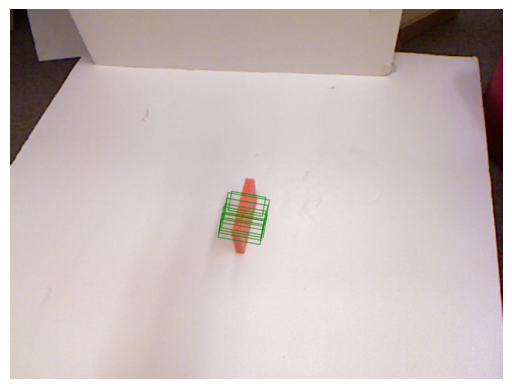

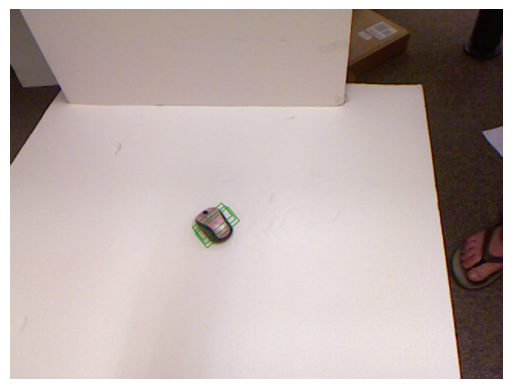

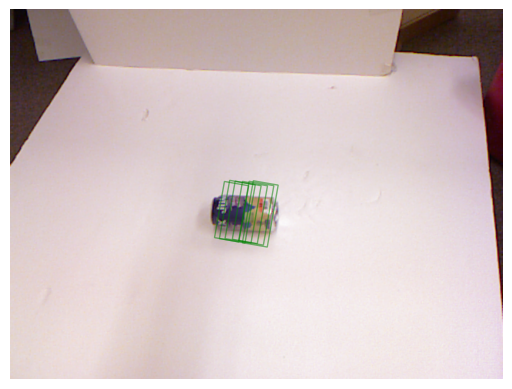

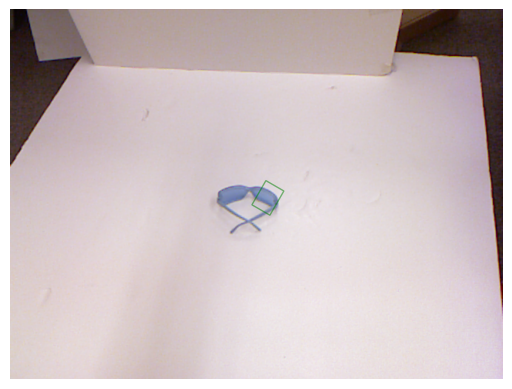

In [6]:
import os
import numpy as np
from numpy import sin, cos, sqrt, pi
import math
import matplotlib.pyplot as plt
from matplotlib.patches import Polygon
files = os.listdir('/kaggle/input/cornell-grasp/cornell_dataset/test/images/')
for file in files:

  # bounding box list
  bbox_list = return_bbox(file)[0] # Add more bounding boxes as needed

  # load the image
  img = plt.imread('/kaggle/input/cornell-grasp/cornell_dataset/test/images/%s'%file)

  fig, ax = plt.subplots(1)
  ax.imshow(img)

  for index, bbox  in enumerate(bbox_list):
      x_c = (bbox[0] + bbox[2]/2)
      y_c = (bbox[1] + bbox[3]/2)

      center = (x_c, y_c)
      width = bbox[2]/2
      height = bbox[3]/2
      degrees = return_bbox(file)[1][index]

      # topleft
      pt1 = [center[0] - width, center[1] - height]
      # btmleft
      pt2 = [center[0] - width, center[1] + height]
      # btmright
      pt3 = [center[0] + width, center[1] + height]
      # topright
      pt4 = [center[0] + width, center[1] - height]

      def rotate(origin, point, angle):
          ox, oy = origin
          px, py = point

          qx = ox + math.cos(angle) * (px - ox) - math.sin(angle) * (py - oy)
          qy = oy + math.sin(angle) * (px - ox) + math.cos(angle) * (py - oy)
          return qx, qy

      rectangle = [pt1, pt2, pt3, pt4]

      rectangle_rotated = [rotate(center, pt,  math.radians(degrees)) for pt in rectangle]

      rectangle = np.array(rectangle)
      rectangle_rotated = np.array(rectangle_rotated)

      coords = rectangle_rotated.tolist()
      bbox = Polygon(coords, facecolor='none', edgecolor='green', linewidth=1, alpha=0.5)
      ax.add_patch(bbox)
  plt.axis('off')
  plt.savefig('/kaggle/working/results/%s'%file,  bbox_inches='tight', pad_inches=0)